# libraries

In [1]:
import cv2
import dlib
import insightface as ins
import matplotlib.pyplot as plt

/Users/tomaszokon/Desktop/WMM-a/.venv/lib/python3.11/site-packages/albumentations/check_version.py:147: UserWarning: Error fetching version info <urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: unable to get local issuer certificate (_ssl.c:1006)>
  data = fetch_version_info()


# Task 1

1. Perform face detection using four detectors on the given test image.  
Propose metrics for evaluating the effectiveness of face detection algorithms and calculate their values for the test image. Always include (in addition to your own proposals):  
- the total number of faces in the image (ground truth, GT),  
- the total number of detections (results returned by the detector),  
- the number of correctly detected faces (true positives, TP),  
- the number of undetected faces (false negatives, FN),  
- the number of objects incorrectly recognized as faces (false positives, FP).  
Consider what relationships exist between these values.  
Collect the results in a table to facilitate comparison.  
Consider how to treat detection results that cover only part of a face, or those that include a significant area of background (non-face) in addition to the face.  
Note: When counting faces in the image, also include partially obscured, rotated, blurred, profile, and rear-view faces, as well as those in the background, in drawings, etc.  
Note: Along with sample test images from the WIDER dataset, a description (ground truth) is provided – you can use it to check and compare which reference faces have been marked on these images (including the given test image).  
Compare and comment on the obtained results.

In [2]:
quality = lambda TP, FP, FN, GT: (TP/(TP + FP)) * (TP/(TP + FN)) / ((TP + FP + FN) / GT)
prec = lambda TP, FP: TP / (TP + FP)
rec = lambda TP, FN: TP / (TP + FN)

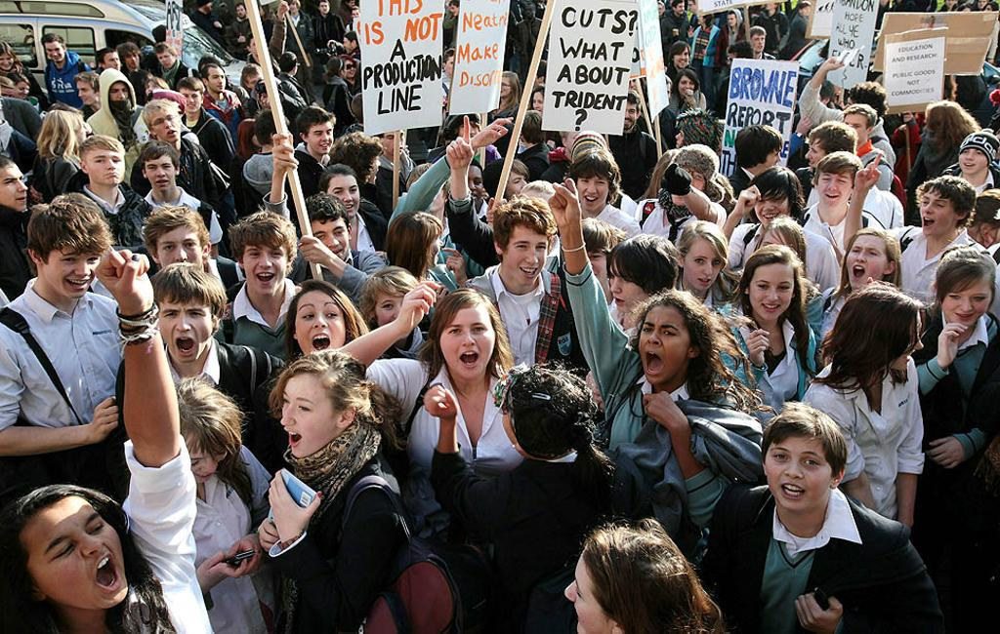

In [3]:
from PIL import Image

img = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_58.jpg")
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

display(Image.fromarray(img_rgb))

[(964, 288, 50, 48), (905, 325, 40, 54), (767, 276, 45, 52), (866, 247, 38, 49), (942, 192, 33, 49), (776, 242, 33, 37), (773, 197, 33, 34), (982, 151, 29, 27), (837, 173, 35, 38), (824, 141, 20, 32), (863, 119, 24, 27), (862, 99, 14, 23), (1007, 6, 9, 11), (1001, 0, 8, 8), (984, 9, 8, 10), (969, 0, 8, 7), (902, 0, 7, 6), (820, 6, 10, 9), (782, 1, 10, 8), (769, 36, 14, 17), (743, 54, 12, 19), (744, 16, 10, 10), (704, 1, 9, 11), (714, 14, 8, 10), (692, 3, 9, 10), (671, 5, 7, 10), (688, 29, 7, 11), (688, 51, 16, 19), (694, 80, 16, 18), (640, 78, 14, 19), (634, 106, 16, 24), (691, 131, 12, 21), (782, 148, 17, 26), (685, 167, 35, 43), (701, 247, 36, 50), (654, 323, 49, 69), (623, 270, 39, 50), (589, 256, 31, 38), (591, 178, 32, 37), (580, 129, 22, 28), (545, 97, 12, 19), (542, 71, 9, 17), (507, 79, 14, 20), (470, 124, 20, 24), (457, 58, 14, 19), (536, 6, 10, 13), (459, 5, 9, 11), (393, 130, 22, 29), (351, 63, 4, 18), (351, 61, 13, 18), (351, 38, 9, 16), (359, 9, 9, 12), (356, 0, 8, 7), (32

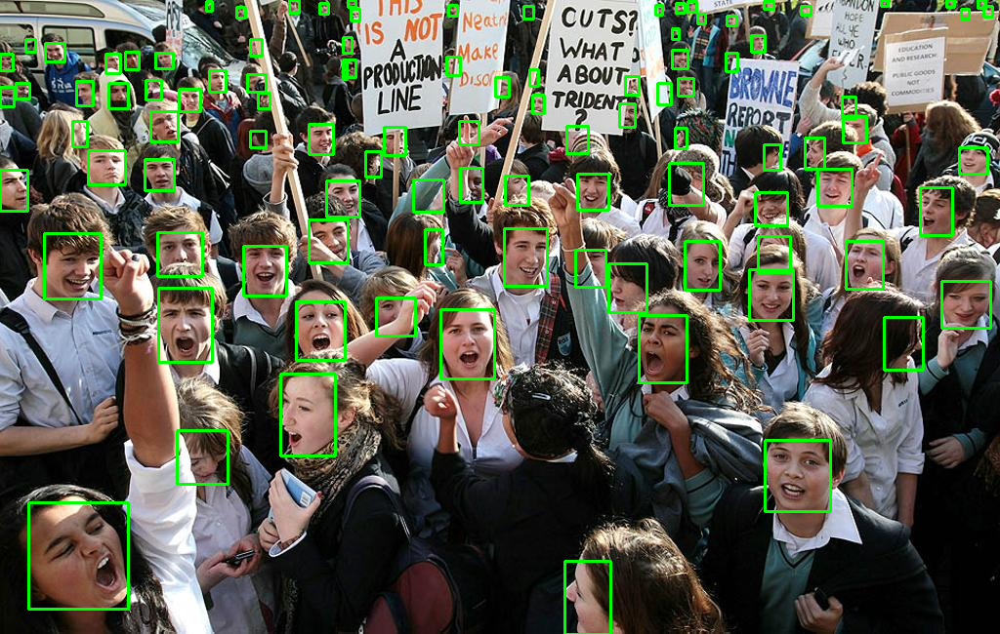

In [4]:
faces = []

with open('ground_truth_bbx.txt', 'r') as f:
    for line in f:
        if line.strip() == '2--Demonstration/2_Demonstration_Demonstration_Or_Protest_2_58.jpg':
            f.readline()
            for i in range(101):
                line = f.readline()
                if line == '':
                    break
                else:
                    line = line.split()
                    x1 = int(line[0])
                    y1 = int(line[1])
                    x2 = int(line[2])
                    y2 = int(line[3])
                    faces.append((x1, y1, x2, y2))

            break 

copy = img_rgb.copy()

for face in faces:
    x1, y1, x2, y2 = face
    cv2.rectangle(copy, (x1, y1), (x1 + x2, y1 + y2), (0, 255, 0), 2)

print(faces)
print(f"Number of faces: {len(faces)}")

display(Image.fromarray(copy))

In [5]:
GT = 101

# Haar's cascade

23


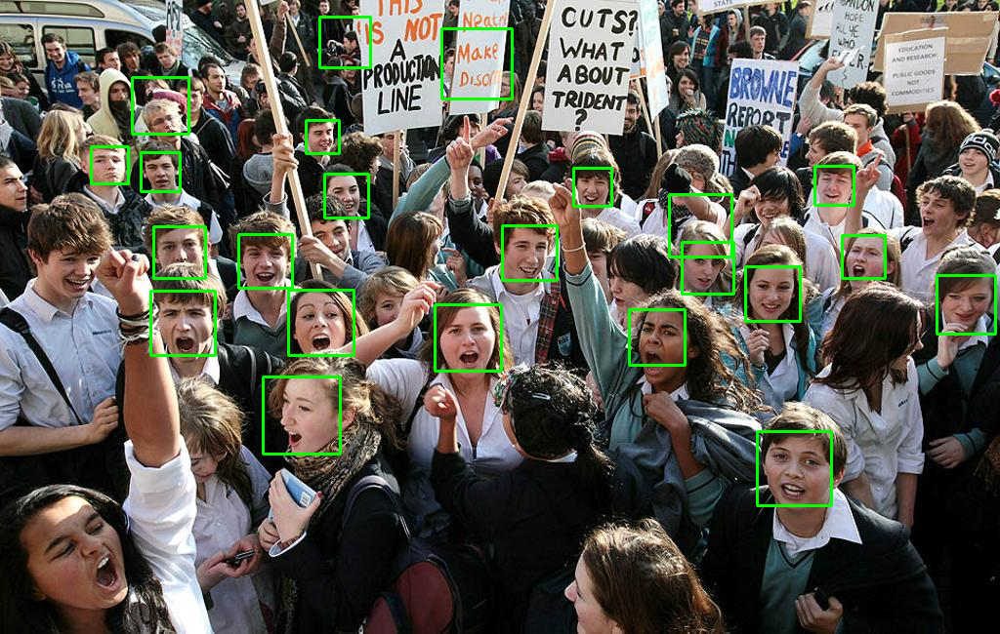

In [6]:
# create and initialize the detector
haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")

# run the detector on the given image (img_gray)
# the result is a list of rectangles in the format [x, y, width, height]
haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
print(len(haar_results))

# draw the results on a copy of the image and display
img_haar = img_rgb.copy()
for (x, y, w, h) in haar_results:
  cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)

display(Image.fromarray(img_haar))

In [7]:
H_TP = 21
H_FP = 2
H_FN = 39
H_quality = quality(H_TP, H_FP, H_FN, GT)
print(f"Haar detection quality: {H_quality:.2f}")

Haar detection quality: 0.52


# Histogram of Oriented Gradients (HOG) with Support Vector Machine (SVM)

21


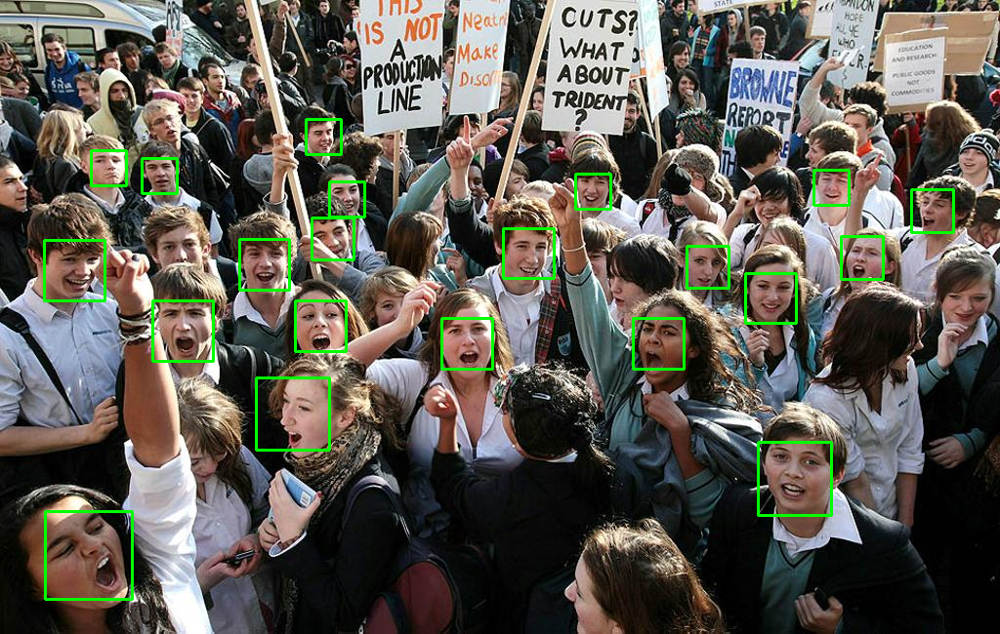

In [8]:
# create and initialize the detector
hog_svm_detector = dlib.get_frontal_face_detector()
# run the detector on the given image (img_rgb)
# the result is a list of rectangle objects containing coordinates of the top-left and bottom-right corners
hog_svm_results = hog_svm_detector(img_rgb, 1)
print(len(hog_svm_results))

# draw the results on a copy of the image and display
img_hog_svm = img_rgb.copy()
for rect in hog_svm_results:
	cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_hog_svm))

In [9]:
HOG_TP = 21
HOG_FP = 0
HOG_FN = 39
HOG_quality = quality(HOG_TP, HOG_FP, HOG_FN, GT)
print(f"HOG+SVM detection quality: {HOG_quality:.2f}")

HOG+SVM detection quality: 0.59


# Convolutional Neural Network (CNN) from the dlib library

27


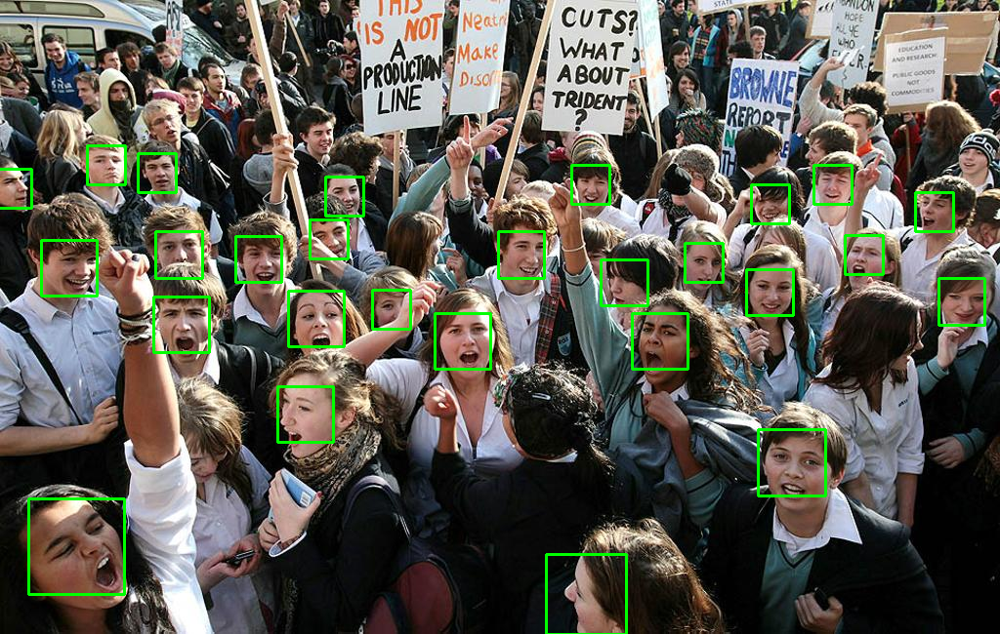

In [10]:
# create and initialize the detector
cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')
# run the detector on the given image (img_rgb)
# the result is a list of mmod_rectangle objects, each containing a rect field with coordinates of the top-left and bottom-right corners of the rectangle
cnn1_results = cnn1_detector(img_rgb, 1)
print(len(cnn1_results))

# draw the results on a copy of the image and display
img_cnn1 = img_rgb.copy()
for res in cnn1_results:
	rect = res.rect
	cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
display(Image.fromarray(img_cnn1))

In [11]:
CNN1_TP = 27
CNN1_FP = 0
CNN1_FN = 33
CNN1_quality = quality(CNN1_TP, CNN1_FP, CNN1_FN, GT)
print(f"Detection quality CNN1: {CNN1_quality:.2f}")

Detection quality CNN1: 0.76


# InsightFace - another neural network

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/w600k_mbf.onnx recognition
set det-size: (1024, 1024)
56


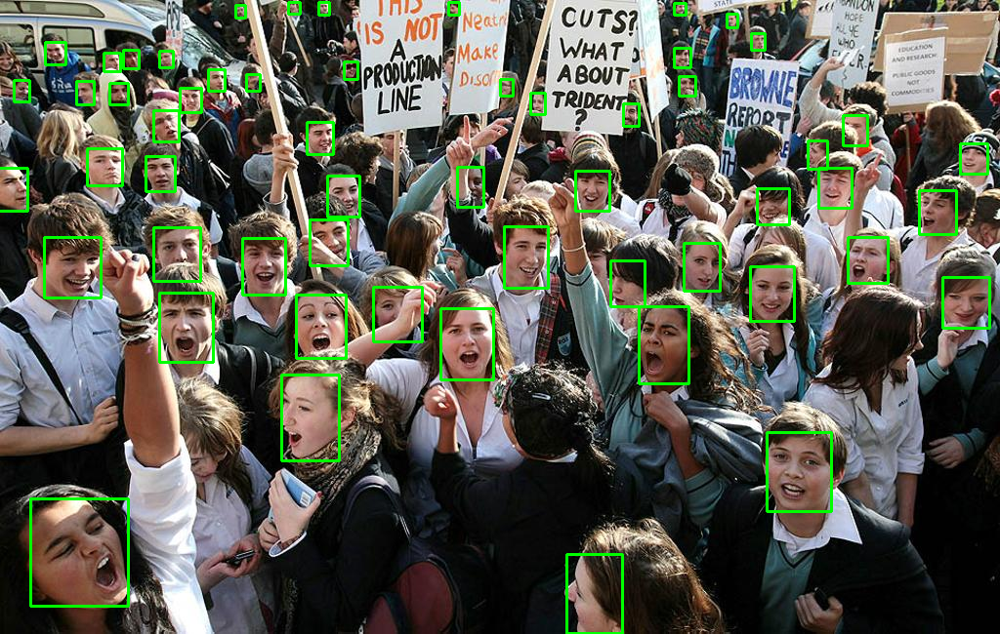

In [12]:
# create and initialize the detector
model_name = 'buffalo_s'  # model: small (_s), medium (_m) or large (_l)
insf_detector = ins.app.FaceAnalysis(name=model_name, root='insightface',
                   allowed_modules=['detection'], providers=['CPUExecutionProvider'])
insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))
# run the detector for the given image
# the result is a list of objects, each containing a bbox field with coordinates of the top-left and bottom-right corners of the rectangle
insf_results = insf_detector.get(img)
print(len(insf_results))

# draw the results on a copy of the image and display
img_insf = img_rgb.copy()
for res in insf_results:
  # rectangle coordinates are stored as floats - convert to integers
  rect = res.bbox.round().astype(int)
  cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
display(Image.fromarray(img_insf))

In [13]:
INS_TP = 56
INS_FP = 0
INS_FN = 4
INS_quality = quality(INS_TP, INS_FP, INS_FN, GT)
print(f"InsightFace detection quality: {INS_quality:.2f}")

InsightFace detection quality: 1.57


In [14]:
for detector in ['Haar', 'HOG+SVM', 'CNN1', 'InsightFace']:
    if detector == 'Haar':
        TP = H_TP
        FP = H_FP
        FN = H_FN
    elif detector == 'HOG+SVM':
        TP = HOG_TP
        FP = HOG_FP
        FN = HOG_FN
    elif detector == 'CNN1':
        TP = CNN1_TP
        FP = CNN1_FP
        FN = CNN1_FN
    else:
        TP = INS_TP
        FP = INS_FP
        FN = INS_FN

    quality_score = quality(TP, FP, FN, GT)
    print(TP, FP, FN, GT)
    print(f"Detection quality {detector}: {quality_score:.2f}")

21 2 39 101
Detection quality Haar: 0.52
21 0 39 101
Detection quality HOG+SVM: 0.59
27 0 33 101
Detection quality CNN1: 0.76
56 0 4 101
Detection quality InsightFace: 1.57


| Detektor       | TP  | FP | FN | GT  | Jakość detekcji | Precyzja | Czułość |
|----------------|-----|----|----|-----|-----------------|----------|---------|
| Haar           | 21  | 2  | 39 | 101 | 0.52            | 0.91     | 0.21    |
| HOG+SVM        | 21  | 0  | 39 | 101 | 0.59            | 1.00     | 0.21    |
| CNN1           | 27  | 0  | 33 | 101 | 0.76            | 1.00     | 0.27    |
| InsightFace    | 56  | 0  | 4  | 101 | 1.57            | 1.00     | 0.55    |

# Conclusions

### Consider what relationships exist between the above values.
TP + FN = GT  
FP is independent of the others, i.e. it can theoretically be in the range <0, ∞>

### Comparison
A clear difference in classifier quality is visible –
Haar was the only one with false positives (FP).
HOG + SVM had similar results, but did not classify any FP.
CNN1 is definitely better, but still far from ideal.
InsightFace, on the other hand, achieved a really good result.

### Consider how to treat detection results that cover only part of a face, or those that include a significant area of background (non-face) in addition to the face.
This is a debatable issue – depending on the desired outcome, such cases can be classified as correct face recognition. In this case, when training, the classifier will be more sensitive, but also more prone to errors.

#   Task 2

Detector: Haar
----------------------
----------------------
----------------------
----------------------
----------------------
8


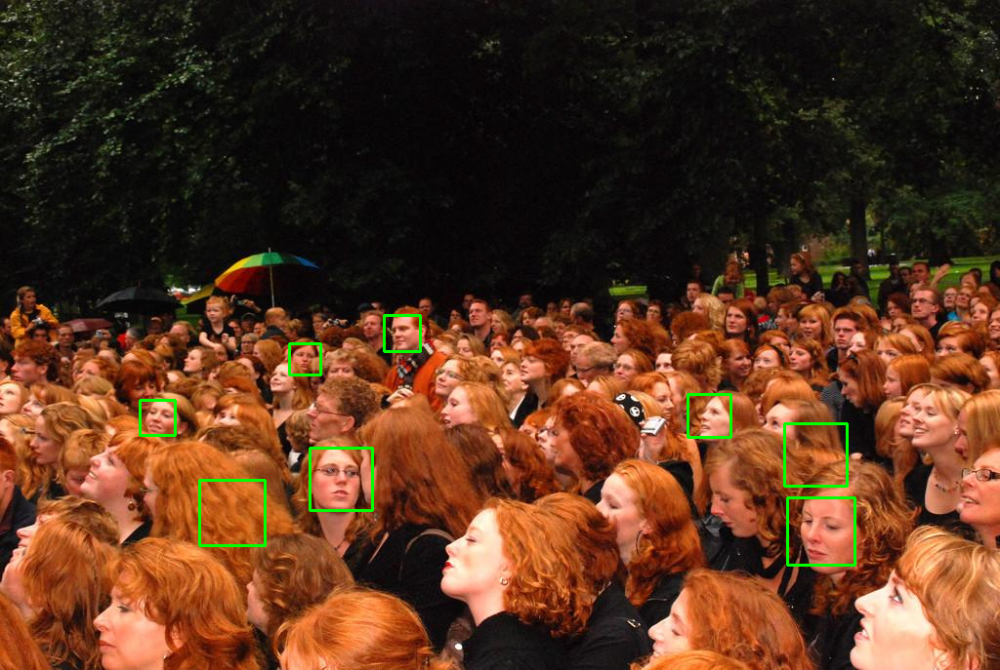

Detector: HOG+SVM
----------------------
----------------------
----------------------
----------------------
----------------------
4


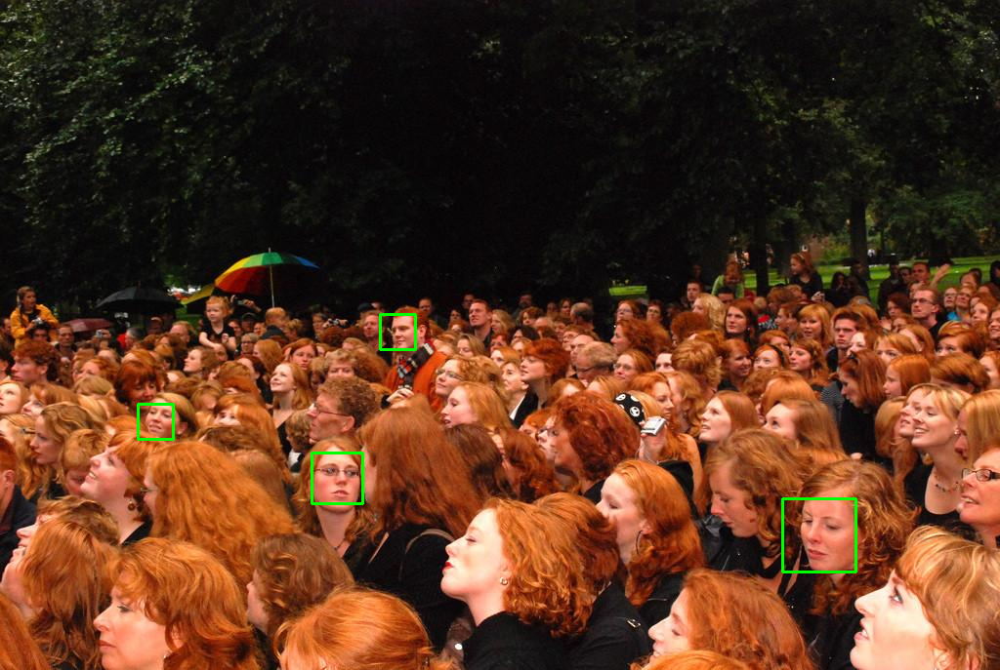

Detector: CNN1
----------------------
----------------------
----------------------
----------------------
----------------------
19


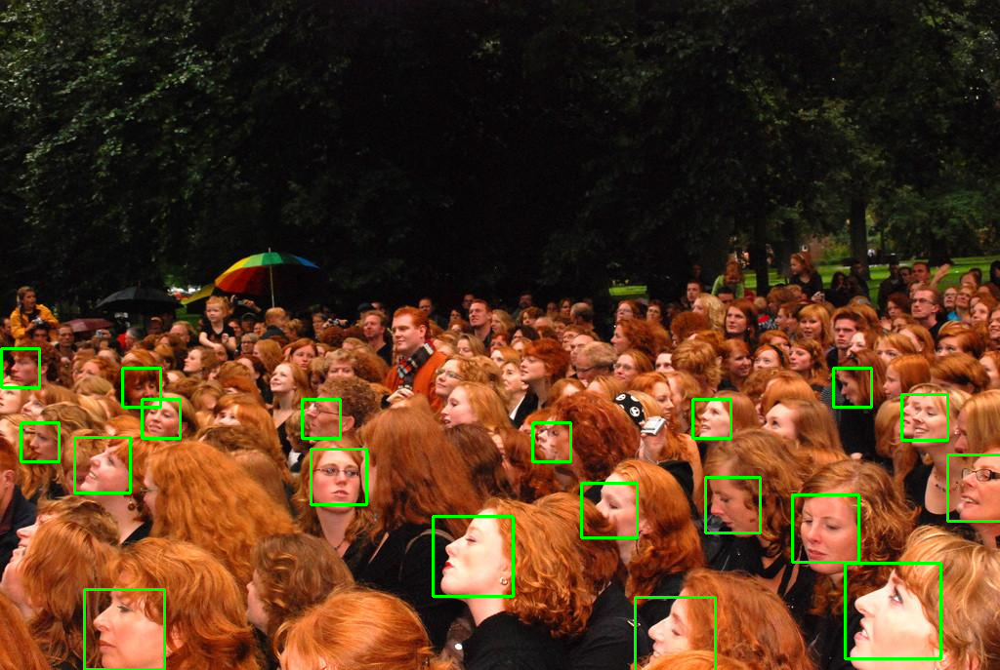

Detector: InsightFace
----------------------
----------------------
----------------------
----------------------
----------------------
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/w600k_mbf.onnx recognition
set det-size: (1024, 1024)
80


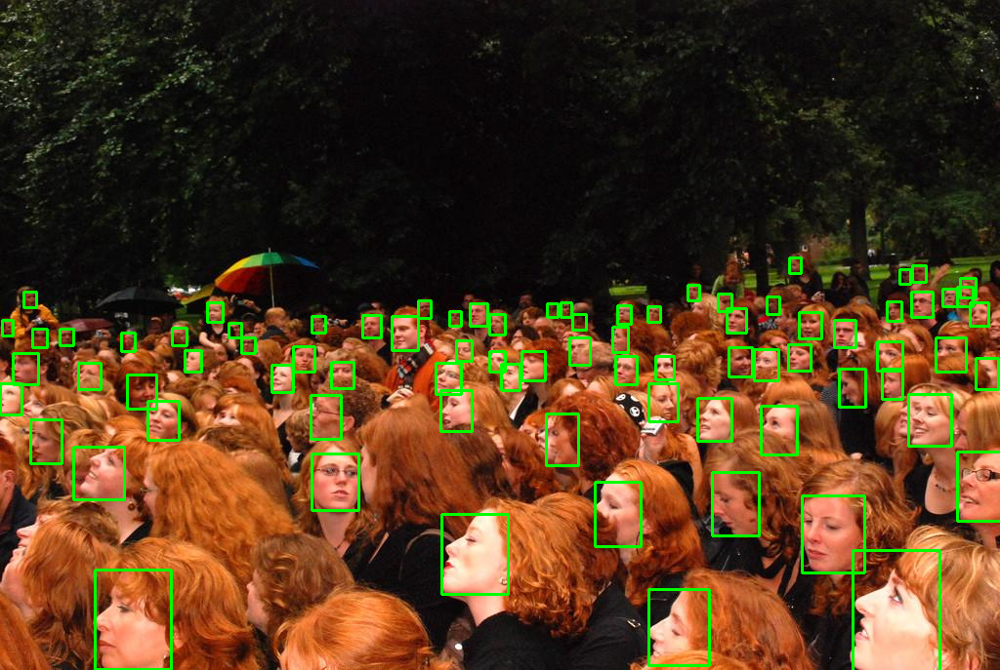

Detector: Haar
----------------------
----------------------
----------------------
----------------------
----------------------
31


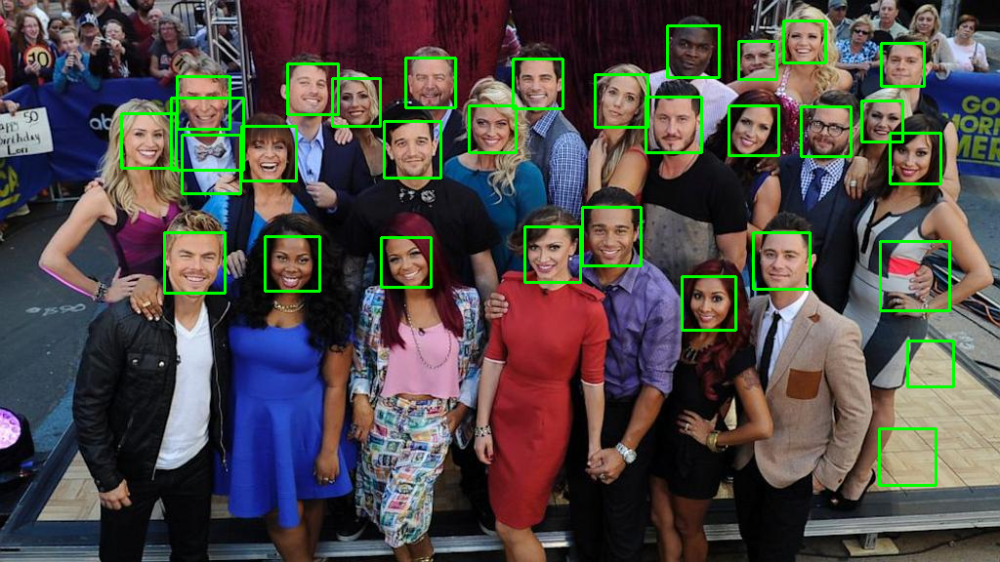

Detector: HOG+SVM
----------------------
----------------------
----------------------
----------------------
----------------------
26


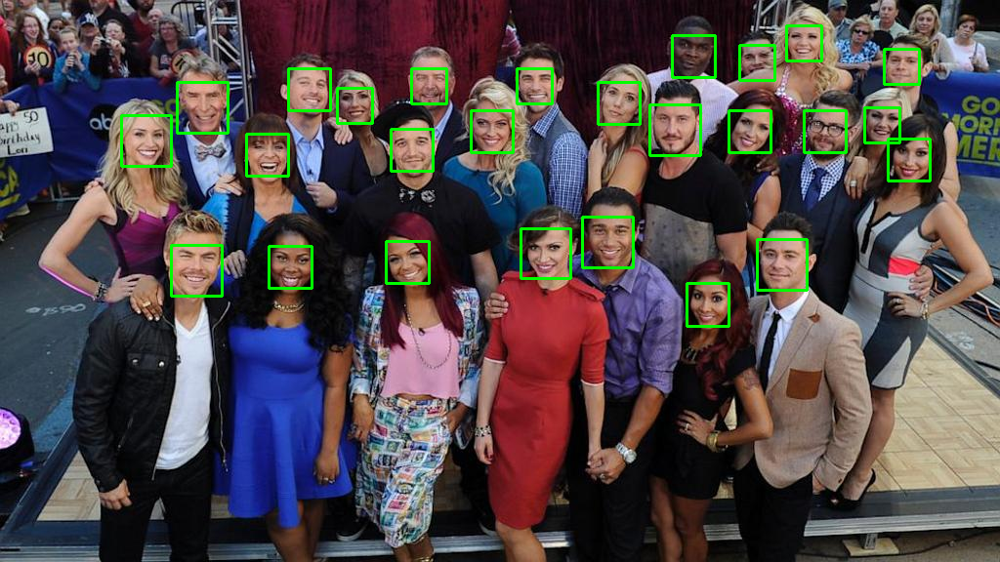

Detector: CNN1
----------------------
----------------------
----------------------
----------------------
----------------------
26


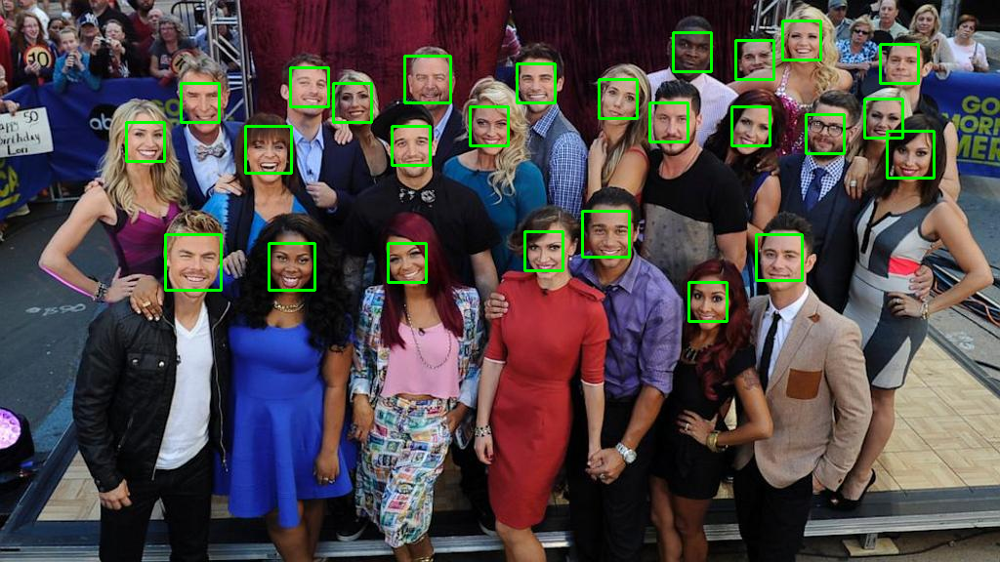

Detector: InsightFace
----------------------
----------------------
----------------------
----------------------
----------------------
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/w600k_mbf.onnx recognition
set det-size: (1024, 1024)
38


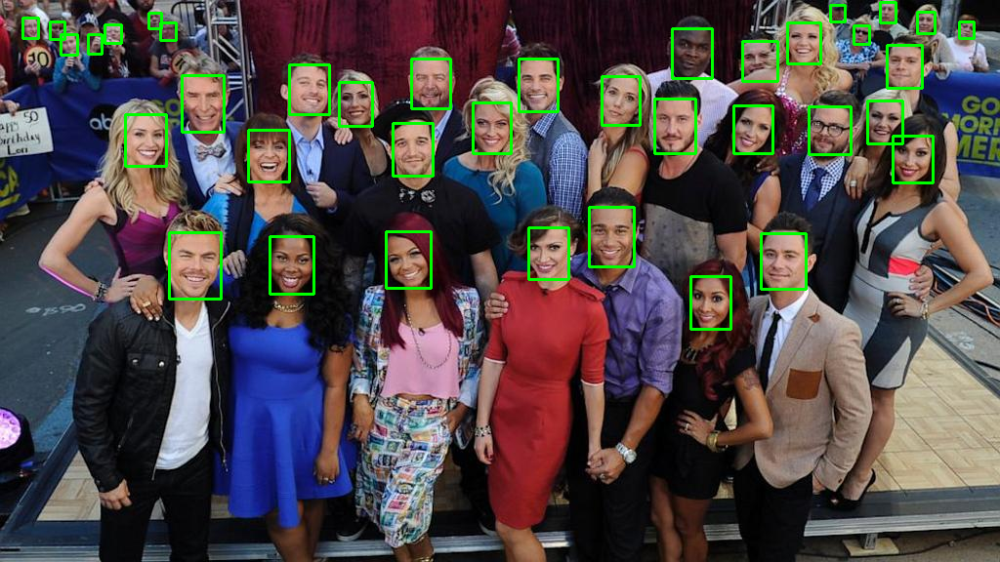

Detector: Haar
----------------------
----------------------
----------------------
----------------------
----------------------
29


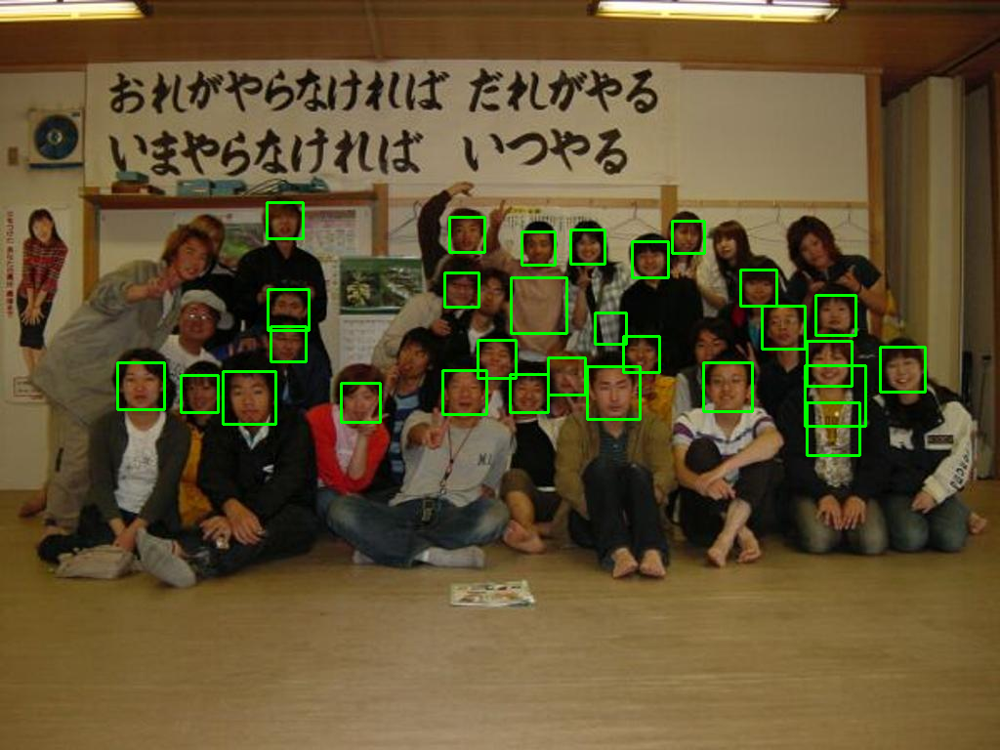

Detector: HOG+SVM
----------------------
----------------------
----------------------
----------------------
----------------------
12


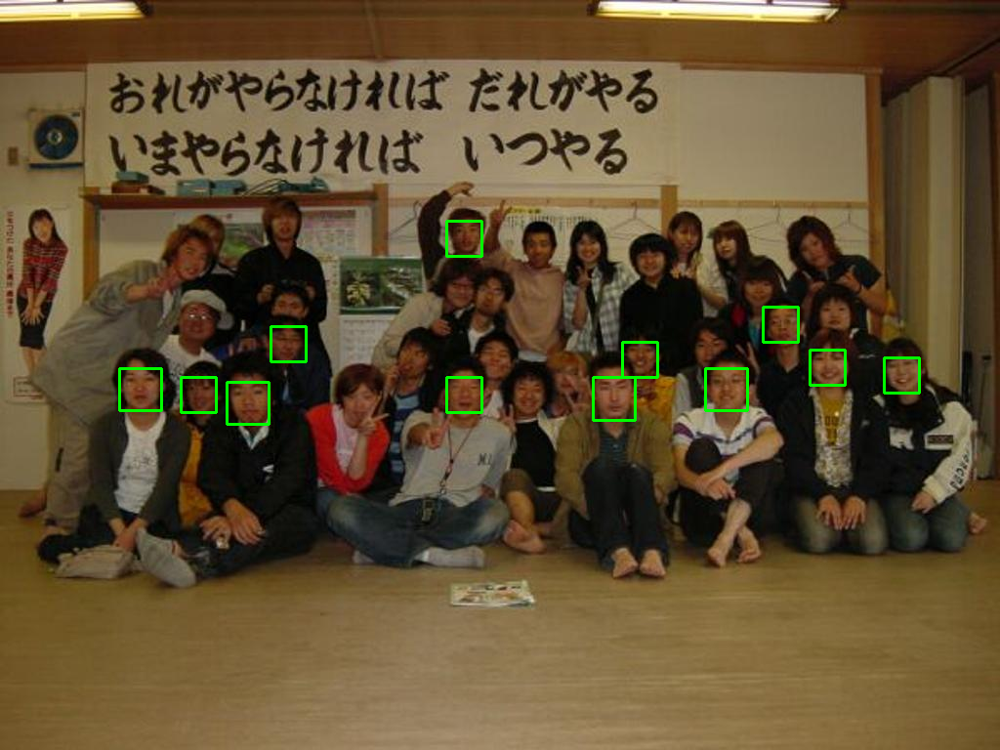

Detector: CNN1
----------------------
----------------------
----------------------
----------------------
----------------------
16


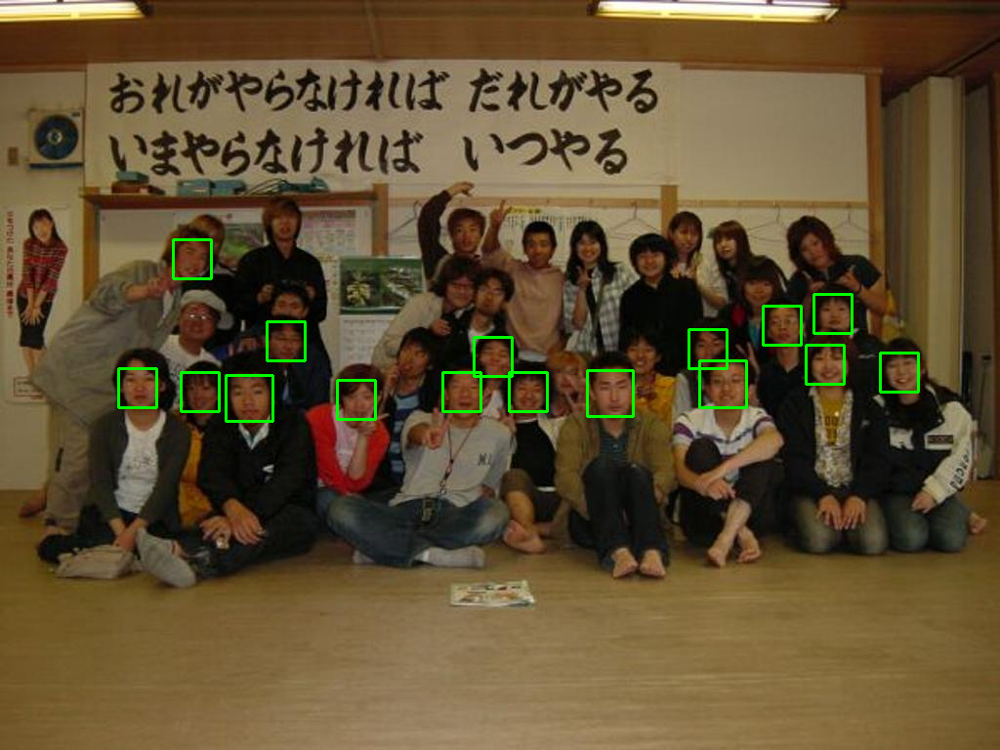

Detector: InsightFace
----------------------
----------------------
----------------------
----------------------
----------------------
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/w600k_mbf.onnx recognition
set det-size: (1024, 1024)
32


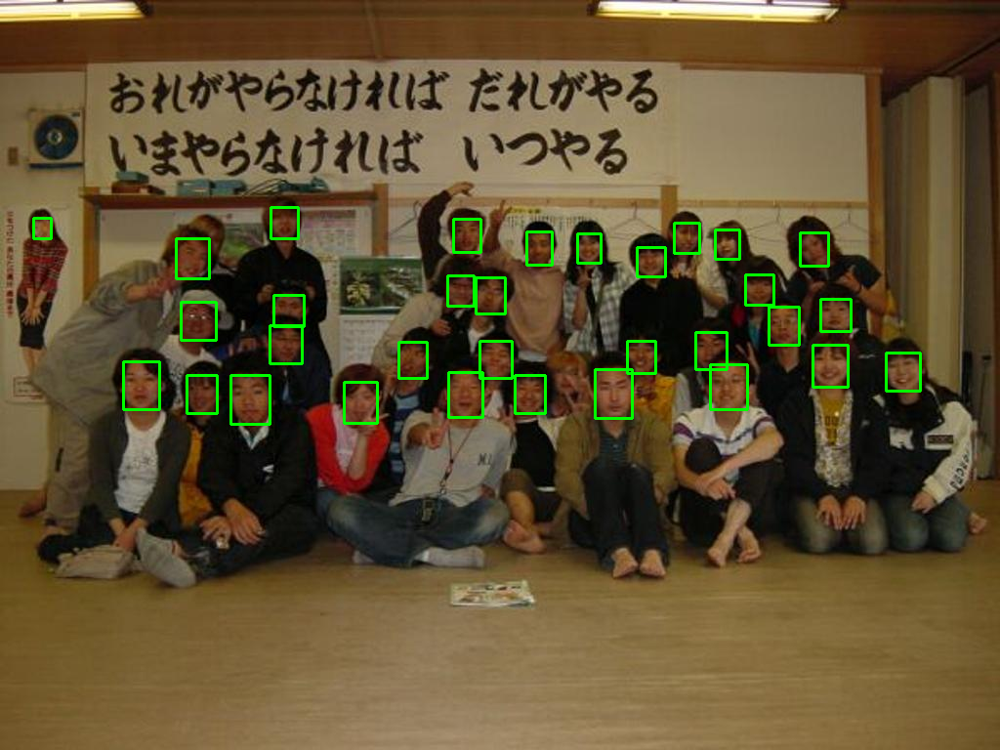

In [15]:
images = []

for path in ['0_Parade_Parade_0_873.jpg', '4_Dancing_Dancing_4_489.jpg', '45_Balloonist_Balloonist_45_838.jpg']:
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    for detector in ['Haar', 'HOG+SVM', 'CNN1', 'InsightFace']:
        print(f"Detector: {detector}")
        for i in range(5):
            print('----------------------')
        if detector == 'Haar':
            haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")
            haar_results = haar_detector.detectMultiScale(img_gray, scaleFactor=1.05, minNeighbors=5, minSize=(30, 30), flags=cv2.CASCADE_SCALE_IMAGE)
            print(len(haar_results))
            img_haar = img_rgb.copy()
            for (x, y, w, h) in haar_results:
                cv2.rectangle(img_haar, (x, y), (x+w, y+h), (0, 255, 0), 2)
            display(Image.fromarray(img_haar))
    
        elif detector == 'HOG+SVM':
            hog_svm_detector = dlib.get_frontal_face_detector()
            hog_svm_results = hog_svm_detector(img_rgb, 1)
            print(len(hog_svm_results))
            img_hog_svm = img_rgb.copy()
            for rect in hog_svm_results:
                cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
            display(Image.fromarray(img_hog_svm))
        elif detector == 'CNN1':
            cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')
            cnn1_results = cnn1_detector(img_rgb, 1)
            print(len(cnn1_results))
            img_cnn1 = img_rgb.copy()
            for res in cnn1_results:
                rect = res.rect
                cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
            display(Image.fromarray(img_cnn1))
        else:
            model_name = 'buffalo_s'
            insf_detector = ins.app.FaceAnalysis(name=model_name, root='insightface',
                                                 allowed_modules=['detection'], providers=['CPUExecutionProvider'])
            insf_detector.prepare(ctx_id=0, det_size=(1024, 1024))
            insf_results = insf_detector.get(img)
            print(len(insf_results))
            img_insf = img_rgb.copy()
            for res in insf_results:
                rect = res.bbox.round().astype(int)
                cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)
            display(Image.fromarray(img_insf))

# Pic 1

GT = 142

### Haar

FP = 2

FN = 136

TP = 6

### HOG

FP = 0

FN = 138

TP = 4

### CNN1

FP = 0

FN = 133

TP = 19

### InsightFace

FP = 0

FN = 62

TP = 80

# Pic 2

GT = 39

### Haar

FP = 4

FN = 12

TP = 27

### HOG

FP = 0

FN = 13

TP = 26

### CNN1

FP = 0

FN = 13

TP = 26

### InsightFace

FP = 0

FN = 1

TP = 38

# Pic 3

GT = 33

### Haar

FP = 4

FN = 4

TP = 25

### HOG

FP = 0

FN = 21

TP = 12

### CNN1

FP = 0

FN = 17

TP = 16

### InsightFace

FP = 0

FN = 1

TP = 32



| Image      | Detector       | GT  | TP  | FP | FN  | Detection Quality | Precision | Recall |
|------------|---------------|-----|-----|----|-----|-------------------|-----------|--------|
| Task1      | Haar           | 60  | 21  | 2  | 39  | 0.31              | 0.91      | 0.35   |
|            | HOG+SVM        | 60  | 21  | 0  | 39  | 0.35              | 1.00      | 0.35   |
|            | CNN1           | 60  | 27  | 0  | 33  | 0.45              | 1.00      | 0.45   |
|            | InsightFace    | 60  | 56  | 0  | 4   | 0.93              | 1.00      | 0.93   |
| Image 1    | Haar           | 142 | 6   | 2  | 136 | 0.02              | 0.75      | 0.04   |
|            | HOG+SVM        | 142 | 4   | 0  | 138 | 0.02              | 1.00      | 0.03   |
|            | CNN1           | 142 | 19  | 0  | 133 | 0.09              | 1.00      | 0.13   |
|            | InsightFace    | 142 | 80  | 0  | 62  | 0.49              | 1.00      | 0.56   |
| Image 2    | Haar           | 39  | 27  | 4  | 12  | 0.50              | 0.87      | 0.69   |
|            | HOG+SVM        | 39  | 26  | 0  | 13  | 0.57              | 1.00      | 0.67   |
|            | CNN1           | 39  | 26  | 0  | 13  | 0.57              | 1.00      | 0.67   |
|            | InsightFace    | 39  | 38  | 0  | 1   | 0.95              | 1.00      | 0.97   |
| Image 3    | Haar           | 33  | 25  | 4  | 4   | 0.68              | 0.86      | 0.86   |
|            | HOG+SVM        | 33  | 12  | 0  | 21  | 0.17              | 1.00      | 0.36   |
|            | CNN1           | 33  | 16  | 0  | 17  | 0.29              | 1.00      | 0.48   |
|            | InsightFace    | 33  | 32  | 0  | 1   | 0.94              | 1.00      | 0.97   |

### Grouped by detector (summed for all images)
| Detector       | GT  | TP  | FP | FN  | Detection Quality | Precision | Recall |
|----------------|-----|-----|----|-----|-------------------|-----------|--------|
| Haar           | 274 | 79  | 12 | 183 | 0.34              | 0.87      | 0.30   |
| HOG+SVM        | 274 | 63  | 0  | 211 | 0.23              | 1.00      | 0.23   |
| CNN1           | 274 | 88  | 0  | 186 | 0.33              | 1.00      | 0.32   |
| InsightFace    | 274 | 206 | 0  | 68  | 0.75              | 1.00      | 0.75   |


Just like with image no. 1:
Haar turns out to be a very weak detector that tends to classify false positives (FP).

HOG + SVM performed even worse in this case, although it did not have any FP cases.

CNN1 also cannot be said to be effective,

while InsightFace, as before, showed really good effectiveness even in the very difficult case of image no. 1.

4. The detectors from the Dlib library (`hog_svm_detector` and `cnn1_detector` in the code) can perform k-times scaling of the input image (second parameter of the detector call). The image size for the InsightFace detector can also be changed (the `det_size` parameter of the `prepare` method).
Check how changing the size of the analyzed image affects the effectiveness of face detection: for Dlib detectors, change the parameter value from 1 to 0 and to 2; for the InsightFace detector, halve and double the values in `det_size`.
Which new faces are found or no longer found? Calculate the values of the metrics proposed in point 1.
Collect the results in a table.
Compare and comment on the obtained results.


In [19]:
img = cv2.imread('0_Parade_Parade_0_873.jpg')
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

for detector in ['HOG+SVM', 'CNN1', 'InsightFace']:
    print(f"Detector: {detector}")
    for i in range(5):
        print('----------------------')
    if detector == 'HOG+SVM':
        for k in [0, 1, 2]:
            print('----------------------')
            print(f"Detector: {detector}")
            print(f'{k} ----------------------')
            hog_svm_detector = dlib.get_frontal_face_detector()
            hog_svm_results = hog_svm_detector(img_rgb, k)
            print(len(hog_svm_results))
            img_hog_svm = img_rgb.copy()
            for rect in hog_svm_results:
                cv2.rectangle(img_hog_svm, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
    elif detector == 'CNN1':
        for k in [0, 1, 2]:
            print('----------------------')
            print(f"Detector: {detector}")
            print(f'{k} ----------------------')
            cnn1_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')
            cnn1_results = cnn1_detector(img_rgb, k)
            print(len(cnn1_results))
            img_cnn1 = img_rgb.copy()
            for res in cnn1_results:
                rect = res.rect
                cv2.rectangle(img_cnn1, (rect.left(), rect.top()), (rect.right(), rect.bottom()), (0, 255, 0), 2)
    else:
        for k in [0, 1, 2]:
            print('----------------------')
            print(f"Detector: {detector}")
            print(f'{k} ----------------------')
            model_name = 'buffalo_s'
            insf_detector = ins.app.FaceAnalysis(name=model_name, root='insightface',
                                                 allowed_modules=['detection'], providers=['CPUExecutionProvider'])
            insf_detector.prepare(ctx_id=0, det_size=[(512, 512), (1024, 1024), (2048, 2048)][k])
            insf_results = insf_detector.get(img)
            print(len(insf_results))
            img_insf = img_rgb.copy()
            for res in insf_results:
                rect = res.bbox.round().astype(int)
                cv2.rectangle(img_insf, (rect[0], rect[1]), (rect[2], rect[3]), (0, 255, 0), 2)

Detector: HOG+SVM
----------------------
----------------------
----------------------
----------------------
----------------------
----------------------
Detector: HOG+SVM
0 ----------------------
2
----------------------
Detector: HOG+SVM
1 ----------------------
4
----------------------
Detector: HOG+SVM
2 ----------------------
15
Detector: CNN1
----------------------
----------------------
----------------------
----------------------
----------------------
----------------------
Detector: CNN1
0 ----------------------
4
----------------------
Detector: CNN1
1 ----------------------
19
----------------------
Detector: CNN1
2 ----------------------
43
Detector: InsightFace
----------------------
----------------------
----------------------
----------------------
----------------------
----------------------
Detector: InsightFace
0 ----------------------
download_path: insightface/models/buffalo_s


100%|██████████| 124617/124617 [00:53<00:00, 2317.58KB/s]


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: insightface/models/buffalo_s/det_500m.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: insightface/models/buffalo_s/w600k_mbf.onnx recognition
set det-size: (512, 512)
32
----------------------
Detector: InsightFace
1 ----------------------
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}

# Comparison

GT = 142

## k = 0

### HOG

TP = 2

FP = 0

FN = 140

### CNN1

TP = 4

FP = 0

FN = 138

### InsightFace

TP = 32

FP = 0

FN = 110

## k = 1

### HOG

TP = 4

FP = 0

FN = 138

### CNN1

TP = 19

FP = 0

FN = 123

### InsightFace

TP = 80

FP = 0

FN = 62

## k = 2

### HOG

TP = 15

FP = 0

FN = 127

### CNN1

TP = 43

FP = 0

FN = 99

### InsightFace

TP = 96

FP = 0

FN = 46



| k   | Detector       | GT  | TP  | FP | FN  | Precision | Recall |
|-----|---------------|-----|-----|----|-----|-----------|--------|
| 0   | HOG           | 142 | 2   | 0  | 140 | 1.00      | 0.01   |
| 0   | CNN1          | 142 | 4   | 0  | 138 | 1.00      | 0.03   |
| 0   | InsightFace   | 142 | 32  | 0  | 110 | 1.00      | 0.23   |
| 1   | HOG           | 142 | 4   | 0  | 138 | 1.00      | 0.03   |
| 1   | CNN1          | 142 | 19  | 0  | 123 | 1.00      | 0.13   |
| 1   | InsightFace   | 142 | 80  | 0  | 62  | 1.00      | 0.56   |
| 2   | HOG           | 142 | 15  | 0  | 127 | 1.00      | 0.11   |
| 2   | CNN1          | 142 | 43  | 0  | 99  | 1.00      | 0.30   |
| 2   | InsightFace   | 142 | 96  | 0  | 46  | 1.00      | 0.68   |

#   Conclusions

Increasing k allows smaller and more distant faces to be detected better; decreasing k has the opposite effect.